<a href="https://colab.research.google.com/github/jismartin/sheva/blob/main/sheva_preliminary_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SHEVA Shapley values for Earned VAlue management

# Preliminary analysis of simulation data

In [1]:
import pandas as pd
import numpy as np
import pickle
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## Monte-Carlo simulation dataset
A case study based on Lambrechts (2008)

<img src='https://drive.google.com/uc?id=1-bCEgplDUqbRSO0NW7stGbLa9xI3DX81' width="400" align="left"/>
<img src='https://drive.google.com/uc?id=1JLt90ba0QGqV8yKzDu0-T-yZTB9-u0lW' width="500" align="left"/>

In [2]:
# Simulation  dataset (load from GitHub reposiotory)
# Null model (5-rand) of comparison
dfsim_5_rand=pd.read_csv('https://raw.githubusercontent.com/jismartin/sheva/main/data/simulation_EV0.75_5-rand.csv',index_col=0)
dfsim_5_rand['critical_path']=dfsim_5_rand['critical_path'].astype('str')
# Interaction between activities 2-5
dfsim_2_5=pd.read_csv('https://raw.githubusercontent.com/jismartin/sheva/main/data/simulation_EV0.75_2-5.csv',index_col=0)
dfsim_2_5['critical_path']=dfsim_2_5['critical_path'].astype('str')

## Time-cost scatter plot at EV = 75% of BAC

In [3]:
print('Null model (5-rand) of comparison')
fig=px.scatter(dfsim_5_rand.sort_values(by='critical_path',ascending=False),x='duration@',y='cost@',
    marginal_x="rug", marginal_y="rug",color='critical_path',height=400,width=500,opacity=0.4,
    labels={'duration@':'time [75%EV]','cost@':'cost [75%EV]'},)
#fig.write_image('./figures/time_cost_scatter_5-rand.pdf',engine='kaleido')
fig.show()

Null model (5-rand) of comparison


In [4]:
print('Conditional interaction between activities 2-5')
fig=px.scatter(dfsim_2_5.sort_values(by='critical_path',ascending=False),x='duration@',y='cost@',
    marginal_x="rug", marginal_y="rug",color='critical_path',height=400,width=500,opacity=0.4,
    labels={'duration@':'time [75%EV]','cost@':'cost [75%EV]'},)
fig.show()

Conditional interaction between activities 2-5


## Distribution of the activities' duration

In [5]:
def duration_histogram(data,duration,title):
  # Duration histograms
  fig = make_subplots(rows=2, cols=4, column_widths=[0.25,0.25,0.25,0.25,], row_heights=[0.5, 0.5],
    specs=[[{"type":"histogram"},{"type":"histogram"},{"type":"histogram"},{"type":"histogram"}],
           [{"type":"histogram"},{"type":"histogram"},{"type":"histogram"},{"type":"histogram"}]],
    subplot_titles=['A'+str(k) for k in range(1,9)])
  # Add histograms
  (r,m)=(1,0)
  for k in range (1,9):
    fig.add_trace( go.Histogram(x=data[duration+str(k)],name='A'+str(k),showlegend=False,
                  marker = dict(color="rgb(0, 0, 255)",opacity=0.5),),row=r,col=k-m)
    if k==4: 
      (r,m)=(r+1,4)
  fig.update_layout(height=400, width=700,title_text=title)
  fig.show()

In [6]:
duration_histogram(dfsim_5_rand,'duration','Null model (5-rand) of comparison')

In [7]:
duration_histogram(dfsim_2_5,'duration','Conditional interaction between activities 2-5')

# Regression

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_squared_error

In [ ]:
# random seed
seed=1123

## Gradient Boosting Regressor


In [ ]:
# Regression models for forward analysis (1)
mdr_forward={'5-rand':GradientBoostingRegressor(max_depth=5, n_estimators=1000,random_state=seed),
     '2-5':GradientBoostingRegressor(max_depth=5, n_estimators=1000,random_state=seed)}

In [ ]:
# Regression models for forward analysis (2)
for (simulation, data) in [('5-rand',dfsim_5_rand),('2-5',dfsim_2_5)]:
  # regression ouput and input variables
  y=data.loc[:,'duration']
  X=data.loc[:,['duration@1','duration@2', 'duration@3','duration@4', 'duration@5','duration@6', 'duration@7','duration@8']]
  # Train the model
  mdr_forward[simulation].fit(X,y)
  print('MSE(%s): %0.4f' % (simulation,mean_squared_error(y,mdr_forward[simulation].predict(X))))

MSE(5-rand): 4.4026
MSE(2-5): 0.3489


In [ ]:
# Save models
for simulation in ['5-rand','2-5']:
  pickle.dump(mdr_forward[simulation], open('./data/mdr_forward_' + simulation + '.pkl', 'wb'))

In [ ]:
# Load models
for simulation in ['5-rand','2-5']:
  mdr_forward[simulation]=pickle.load(open('./data/mdr_forward_' + simulation + '.pkl', 'rb'))

In [ ]:
# Regression models for backward analysis (1)
mdr_backward={'5-rand':GradientBoostingRegressor(max_depth=5, n_estimators=1000,random_state=seed),
     '2-5':GradientBoostingRegressor(max_depth=5, n_estimators=1000,random_state=seed)}

In [ ]:
# Regression models for forward analysis (2)
for (simulation, data) in [('5-rand',dfsim_5_rand),('2-5',dfsim_2_5)]:
  # regression ouput and input variables
  y=data.loc[:,'duration@']
  X=data.loc[:,['duration@1','duration@2', 'duration@3','duration@4', 'duration@5','duration@6', 'duration@7','duration@8']]
  # Train the model
  mdr_backward[simulation].fit(X,y)
  print('MSE(%s): %0.4f' % (simulation,mean_squared_error(y,mdr_backward[simulation].predict(X))))

MSE(5-rand): 0.0002
MSE(2-5): 0.0002


In [ ]:
# Save models
for simulation in ['5-rand','2-5']:
  pickle.dump(mdr_backward[simulation], open('./data/mdr_backward_' + simulation + '.pkl', 'wb'))

In [ ]:
# Load models
for simulation in ['5-rand','2-5']:
  mdr_backward[simulation]=pickle.load(open('./data/mdr_backward_' + simulation + '.pkl', 'rb'))

# Shapley values for regression model

In [ ]:
!pip install -q shap


     |▋                               | 10 kB 28.8 MB/s eta 0:00:01
     |█▏                              | 20 kB 33.1 MB/s eta 0:00:01
     |█▊                              | 30 kB 19.0 MB/s eta 0:00:01
     |██▎                             | 40 kB 6.2 MB/s eta 0:00:01
     |███                             | 51 kB 5.2 MB/s eta 0:00:01
     |███▌                            | 61 kB 6.2 MB/s eta 0:00:01
     |████                            | 71 kB 6.9 MB/s eta 0:00:01
     |████▋                           | 81 kB 7.1 MB/s eta 0:00:01
     |█████▏                          | 92 kB 7.9 MB/s eta 0:00:01
     |█████▉                          | 102 kB 6.6 MB/s eta 0:00:01
     |██████▍                         | 112 kB 6.6 MB/s eta 0:00:01
     |███████                         | 122 kB 6.6 MB/s eta 0:00:01
     |███████▌                        | 133 kB 6.6 MB/s eta 0:00:01
     |████████▏                       | 143 kB 6.6 MB/s eta 0:00:01
     |████████▊                       | 153 kB 6.6 MB

In [ ]:
import shap
import matplotlib.pyplot as plt
print('SHAP version:',shap.__version__)

SHAP version: 0.40.0


In [ ]:
# Load JS (requiered for showing plots)
shap.initjs()

## Compute Shapley values

In [ ]:
# Shapley values - forward regression (1)
shap_values_forward=dict()
explainer_forward=dict()

In [ ]:
# Shapley values - forward regression (2)
for (simulation, data) in [('5-rand',dfsim_5_rand),('2-5',dfsim_2_5)]:
  X=data.loc[:,['duration@1','duration@2', 'duration@3','duration@4', 'duration@5','duration@6', 'duration@7','duration@8']]
  explainer_forward.update({simulation:shap.Explainer(mdr_forward[simulation])})
  shap_values_forward.update({simulation:explainer_forward[simulation](X)})
  shap_values_forward[simulation].feature_names=[ 'A'+str(i) for i in range(1,9)]


In [ ]:
# save
for simulation in ['5-rand','2-5']:
  pickle.dump(explainer_forward[simulation], open('./data/explainer_forward_' + simulation + '.pkl', 'wb'))
  pickle.dump(shap_values_forward[simulation], open('./data/shap_values_forward_' + simulation + '.pkl', 'wb'))

In [ ]:
# load
for simulation in ['5-rand','2-5']:
  explainer_forward[simulation]=pickle.load(open('./data/explainer_forward_' + simulation + '.pkl', 'rb'))
  shap_values_forward[simulation]=pickle.load(open('./data/shap_values_forward_' + simulation + '.pkl', 'rb'))

In [ ]:
# Shapley values - backward regression (1)
shap_values_backward=dict()
explainer_backward=dict()

In [ ]:
# Shapley values - backward regression (2)
for (simulation, data) in [('5-rand',dfsim_5_rand),('2-5',dfsim_2_5)]:
  X=data.loc[:,['duration@1','duration@2', 'duration@3','duration@4', 'duration@5','duration@6', 'duration@7','duration@8']]
  explainer_backward.update({simulation:shap.Explainer(mdr_backward[simulation])})
  shap_values_backward.update({simulation:explainer_backward[simulation](X)})
  shap_values_backward[simulation].feature_names=[ 'A'+str(i) for i in range(1,9)]

In [ ]:
# save
for simulation in ['5-rand','2-5']:
  pickle.dump(explainer_backward[simulation], open('./data/explainer_backward_' + simulation + '.pkl', 'wb'))
  pickle.dump(shap_values_backward[simulation], open('./data/shap_values_backward_' + simulation + '.pkl', 'wb'))

In [ ]:
# load
for simulation in ['5-rand','2-5']:
  explainer_backward[simulation]=pickle.load(open('./data/explainer_backward_' + simulation + '.pkl', 'rb'))
  shap_values_backward[simulation]=pickle.load(open('./data/shap_values_backward_' + simulation + '.pkl', 'rb'))

# Forward analysis

Null model (5-rand) of comparison


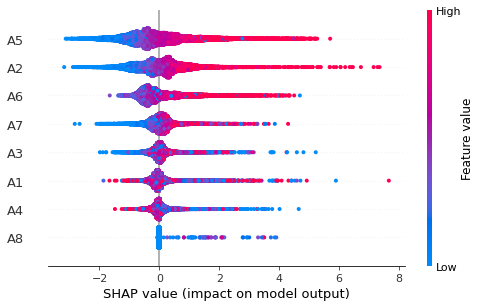

In [ ]:
# Summary Shapley values plot (1)
print('Null model (5-rand) of comparison')
shap.summary_plot(shap_values_forward['5-rand'])

Conditional interaction between activities 2-5


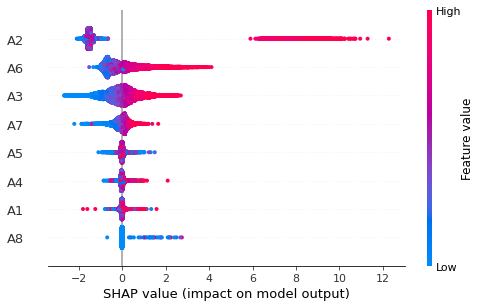

In [ ]:
# Summary Shapley values plot (2)
print('Conditional interaction between activities 2-5')
shap.summary_plot(shap_values_forward['2-5'])

In [ ]:
# Dependence plots (1)
print('Null model (5-rand) of comparison')
simulation='5-rand'
df=pd.DataFrame([],columns=['Value','ShapleyV','Activity','End'])
for k in range(shap_values_forward[simulation].data.shape[1]):
  d={'Value':shap_values_forward[simulation].data[:,k],
     'ShapleyV':shap_values_forward[simulation].values[:,k],
      'Activity':['A'+str(k+1) for i in range(shap_values_forward[simulation].data[:,k].shape[0])],
      'End':data['duration'].values}
  df=df.append(pd.DataFrame(d))
df.reset_index(inplace=True)
fig=px.scatter(x=df['Value'],y=df['ShapleyV'],facet_col=df['Activity'],
                 labels={'y':'Shapley values','x':'d','color':'duration'},color=df['End'])
fig.show()

Null model (5-rand) of comparison


# Backward analysis

In [ ]:
# Random instance with A2's duration greater then the threshold
th=4+np.sqrt(0.83)
i=dfsim_2_5[dfsim_2_5['duration2']>th].sample(1).index[0]
print('instance %i' %i)

instance 14100


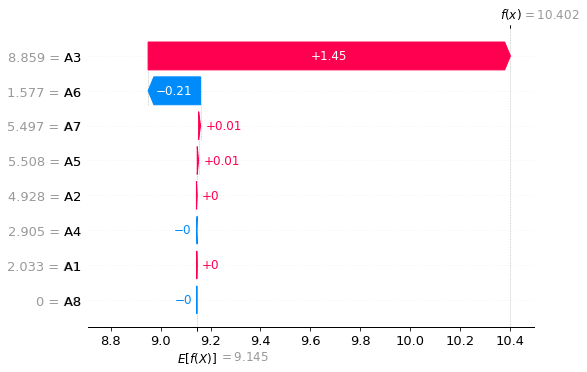

In [ ]:
# Waterfall plot
#shap.plots.waterfall(explainer2.expected_value, shap_values2.values[i,:])
# There is a bug in the current version with waterfall plot 
# (see https://github.com/slundberg/shap/issues/1420)
shap_object = shap.Explanation(base_values = shap_values_backward['2-5'][i][0].base_values,
    values = shap_values_backward['2-5'][i].values,
    feature_names = shap_values_backward['2-5'].feature_names,
    data = shap_values_backward['2-5'][i].data)
shap.plots.waterfall(shap_object)

In [ ]:
# Random instance with A2's duration lower then the threshold
th=4+np.sqrt(0.83)
i2=dfsim_2_5[dfsim_2_5['duration2']<th].sample(1).index[0]
print('instance %i' %i2)

instance 16226


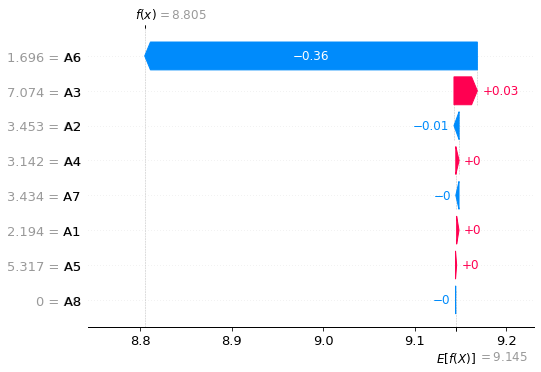

In [ ]:
# Waterfall plot
#shap.plots.waterfall(explainer2.expected_value, shap_values2.values[i,:])
# There is a bug in the current version with waterfall plot 
# (see https://github.com/slundberg/shap/issues/1420)
shap_object = shap.Explanation(base_values = shap_values_backward['2-5'][i2][0].base_values,
    values = shap_values_backward['2-5'][i2].values,
    feature_names = shap_values_backward['2-5'].feature_names,
    data = shap_values_backward['2-5'][i2].data)
shap.plots.waterfall(shap_object)

In [ ]:
# For checking the sample (remove!!!!!)
X=dfsim_2_5.loc[:,['duration@1','duration@2', 'duration@3','duration@4', 'duration@5','duration@6', 'duration@7','duration@8']]
print('Duration@ ', dfsim_2_5.loc[i2,'duration@'])
print('Prediction@ ', mdr_backward['2-5'].predict(X)[i2])

Duration@  8.770021350256114
Prediction@  8.80499000206452
